# Restaurant Revenue Forecasting Model


The goal of this project is to develop an end-to-end regression ML model for revenue prediction. The code is based on the project https://github.com/allenkong221 y https://www.coursera.org/projects/curso-completo-data-science



## Part I

## Data

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
#!pip install --upgrade pandas
#pip install ydata-profiling
#pip install pandas-profiling

In [3]:
%matplotlib inline
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib
from scipy import stats
from scipy.stats import norm, skew
from sklearn import preprocessing
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor, plot_importance
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import KFold

for dirname, _, filenames in os.walk('/Dataset'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

In [4]:
df = pd.read_csv('/Dataset/train.csv')
df.shape

(137, 43)

In [5]:
test_df = pd.read_csv('/Dataset/test.csv')
test_df.shape

(100000, 42)

In [11]:
df.head()

,Id,Open Date,City,City Group,Type,P1,P2,P3,P4,P5,...,P29,P30,P31,P32,P33,P34,P35,P36,P37,revenue
0,0,07/17/1999,İstanbul,Big Cities,IL,4,5.0,4.0,4.0,2,...,3.0,5,3,4,5,5,4,3,4,5653753.0
1,1,02/14/2008,Ankara,Big Cities,FC,4,5.0,4.0,4.0,1,...,3.0,0,0,0,0,0,0,0,0,6923131.0
2,2,03/09/2013,Diyarbakır,Other,IL,2,4.0,2.0,5.0,2,...,3.0,0,0,0,0,0,0,0,0,2055379.0
3,3,02/02/2012,Tokat,Other,IL,6,4.5,6.0,6.0,4,...,7.5,25,12,10,6,18,12,12,6,2675511.0
4,4,05/09/2009,Gaziantep,Other,IL,3,4.0,3.0,4.0,2,...,3.0,5,1,3,2,3,4,3,3,4316715.0


In [12]:
df.describe()

,Id,P1,P2,P3,P4,P5,P6,P7,P8,P9,...,P29,P30,P31,P32,P33,P34,P35,P36,P37,revenue
count,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,...,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,137.000000,1.370000e+02
mean,68.000000,4.014599,4.408759,4.317518,4.372263,2.007299,3.357664,5.423358,5.153285,5.445255,...,3.135036,2.729927,1.941606,2.525547,1.138686,2.489051,2.029197,2.211679,1.116788,4.453533e+06
std,39.692569,2.910391,1.514900,1.032337,1.016462,1.209620,2.134235,2.296809,1.858567,1.834793,...,1.680887,5.536647,3.512093,5.230117,1.698540,5.165093,3.436272,4.168211,1.790768,2.576072e+06
min,0.000000,1.000000,1.000000,0.000000,3.000000,1.000000,1.000000,1.000000,1.000000,4.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.149870e+06
25%,34.000000,2.000000,4.000000,4.000000,4.000000,1.000000,2.000000,5.000000,4.000000,4.000000,...,2.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.999068e+06
50%,68.000000,3.000000,5.000000,4.000000,4.000000,2.000000,3.000000,5.000000,5.000000,5.000000,...,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.939804e+06
75%,102.000000,4.000000,5.000000,5.000000,5.000000,2.000000,4.000000,5.000000,5.000000,5.000000,...,3.000000,4.000000,3.000000,3.000000,2.000000,3.000000,4.000000,3.000000,2.000000,5.166635e+06
max,136.000000,12.000000,7.500000,7.500000,7.500000,8.000000,10.000000,10.000000,10.000000,10.000000,...,7.500000,25.000000,15.000000,25.000000,6.000000,24.000000,15.000000,20.000000,8.000000,1.969694e+07


## Transposed Records

In [6]:
def display_all(df):
    with pd.option_context("display.max_rows", 1000, "display.max_columns", 1000): 
        display(df)

display_all(df.head().transpose())

,0,1,2,3,4
Id,0,1,2,3,4
Open Date,07/17/1999,02/14/2008,03/09/2013,02/02/2012,05/09/2009
City,İstanbul,Ankara,Diyarbakır,Tokat,Gaziantep
City Group,Big Cities,Big Cities,Other,Other,Other
Type,IL,FC,IL,IL,IL
P1,4,4,2,6,3
P2,5.0,5.0,4.0,4.5,4.0
P3,4.0,4.0,2.0,6.0,3.0
P4,4.0,4.0,5.0,6.0,4.0
P5,2,1,2,4,2


#### Null Values

In [14]:
df.isnull().sum().sort_index()/len(df)

City          0.0
City Group    0.0
Id            0.0
Open Date     0.0
P1            0.0
P10           0.0
P11           0.0
P12           0.0
P13           0.0
P14           0.0
P15           0.0
P16           0.0
P17           0.0
P18           0.0
P19           0.0
P2            0.0
P20           0.0
P21           0.0
P22           0.0
P23           0.0
P24           0.0
P25           0.0
P26           0.0
P27           0.0
P28           0.0
P29           0.0
P3            0.0
P30           0.0
P31           0.0
P32           0.0
P33           0.0
P34           0.0
P35           0.0
P36           0.0
P37           0.0
P4            0.0
P5            0.0
P6            0.0
P7            0.0
P8            0.0
P9            0.0
Type          0.0
revenue       0.0
dtype: float64

### variable type: comparative df and df_test

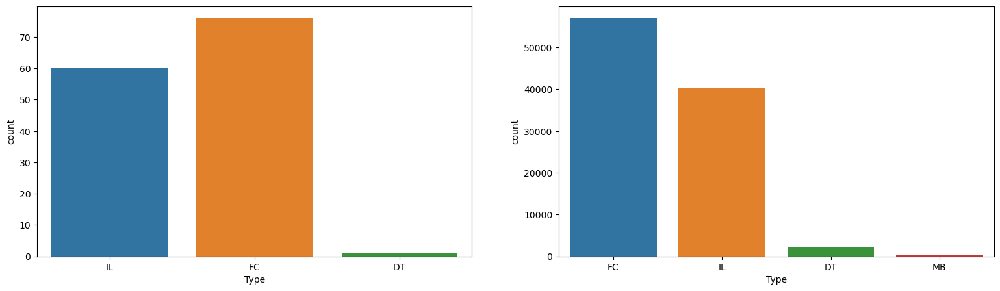

In [9]:
fig, ax = plt.subplots(1,2, figsize=(19, 5))
g1 = sns.countplot(df,x="Type",ax=ax[0]);
g2 = sns.countplot(test_df, x= "Type",ax=ax[1]);
plt.show()

### variable City Group: comparative df and df_test

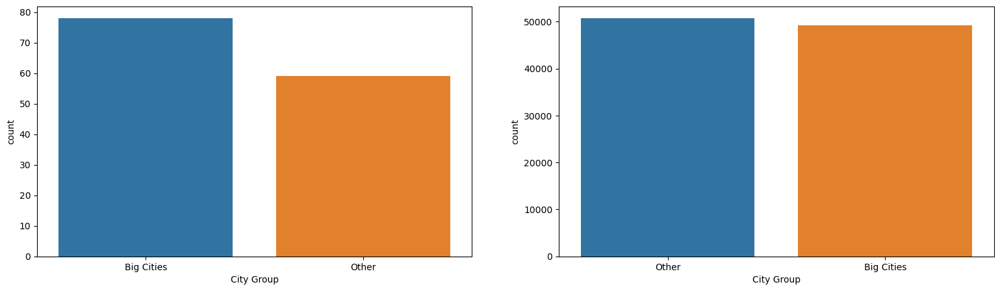

In [10]:
fig, ax = plt.subplots(1,2, figsize=(19, 5))
g1 = sns.countplot(df, x = "City Group", ax=ax[0]);
g2 = sns.countplot(test_df, x= "City Group", ax=ax[1]);
plt.show()

#### unique values of the city variable

In [7]:
(df['City'].nunique(), test_df['City'].nunique())

(34, 57)

### Variable replacement
The **MB** type will be replaced with the **DT** type in the test set since it is not available in our training set.

In [8]:
test_df.loc[test_df['Type']=='MB', 'Type'] = 'DT'

### Variable elimination
The **City** function is useless since our training set contains **34** unique cities, but the test set contains **57** unique cities.

In [9]:
df.drop('City', axis=1, inplace=True)
test_df.drop('City', axis=1, inplace=True)

### Date transformation

In [ ]:
import datetime
#remove ID variable
df.drop('Id',axis=1,inplace=True)

#transform date
df['Open Date']  = pd.to_datetime(df['Open Date'])
test_df['Open Date']  = pd.to_datetime(test_df['Open Date'])

#specific date to count the opening days
launch_date = datetime.datetime(2015, 3, 23)
# scale days open: diferencias de fechas ajustar a 1000
df['Days Open'] = (launch_date - df['Open Date']).dt.days / 1000
test_df['Days Open'] = (launch_date - test_df['Open Date']).dt.days / 1000

#remove Open Date variable
df.drop('Open Date', axis=1, inplace=True)
test_df.drop('Open Date', axis=1, inplace=True)

### Analysis of P-type variables
The data has 37 P variables. These variables contain demographic data, real estate data and business data based according to the Kaggle page

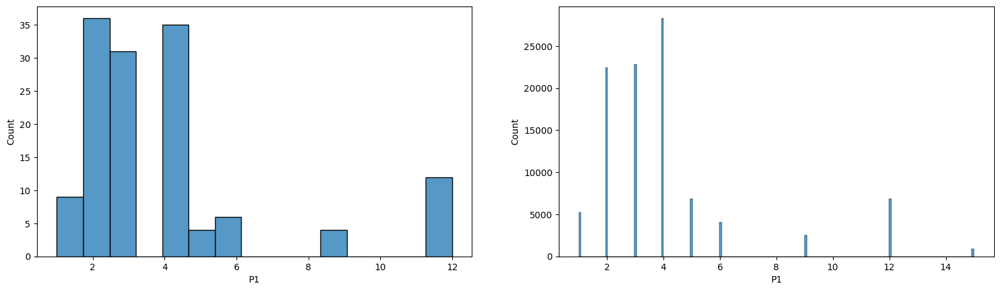

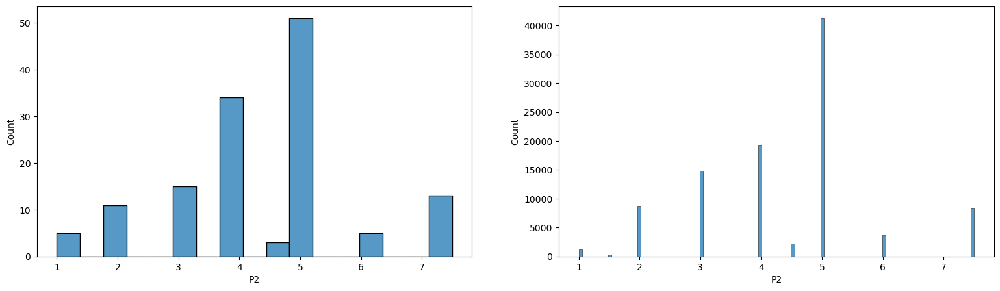

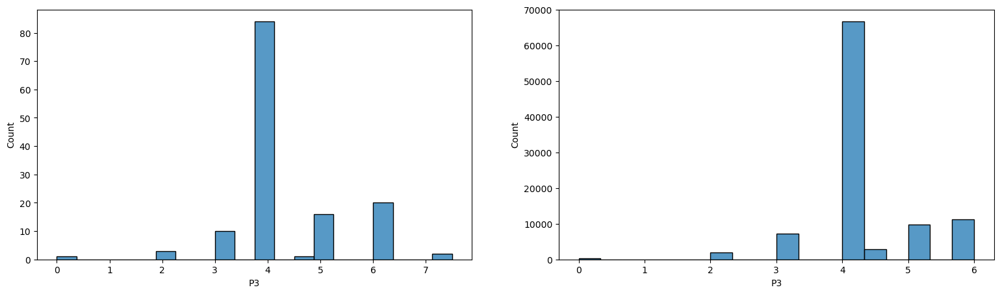

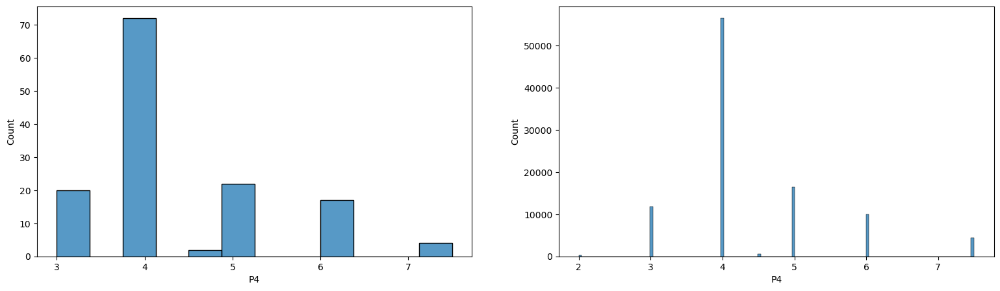

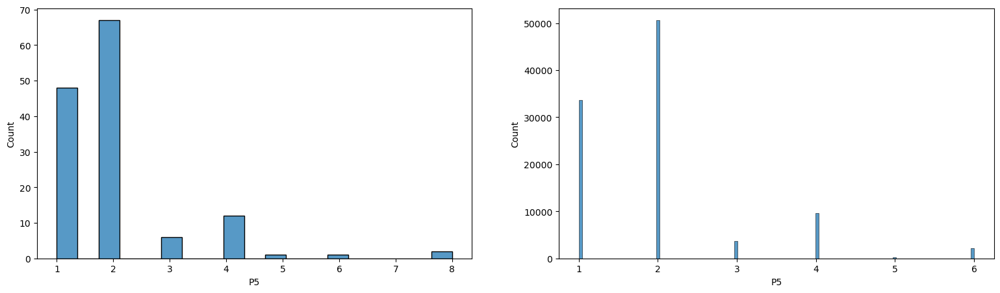

...

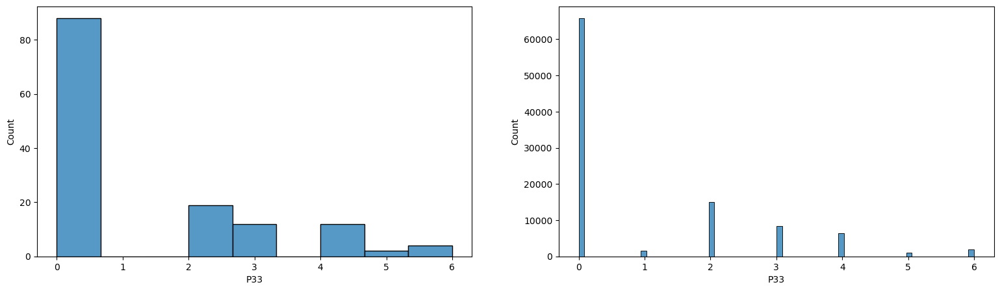

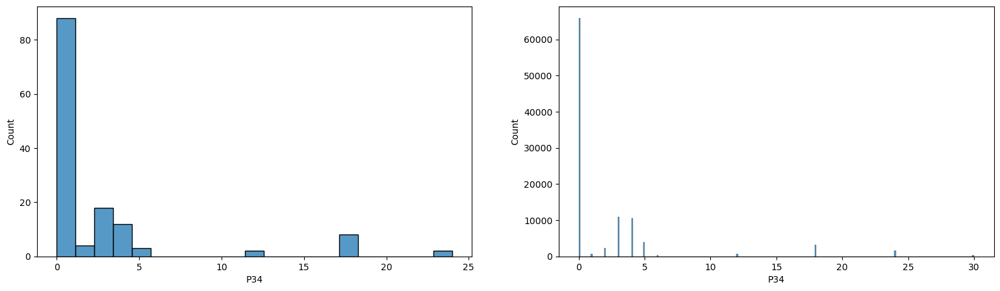

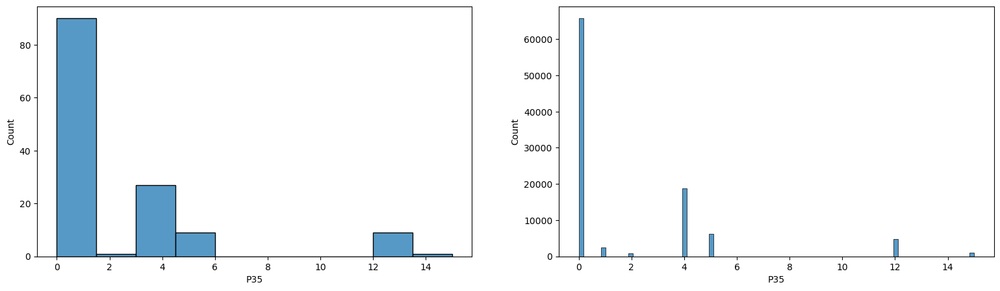

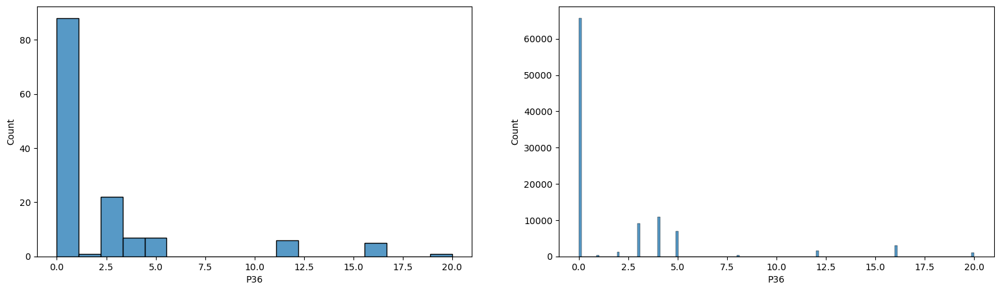

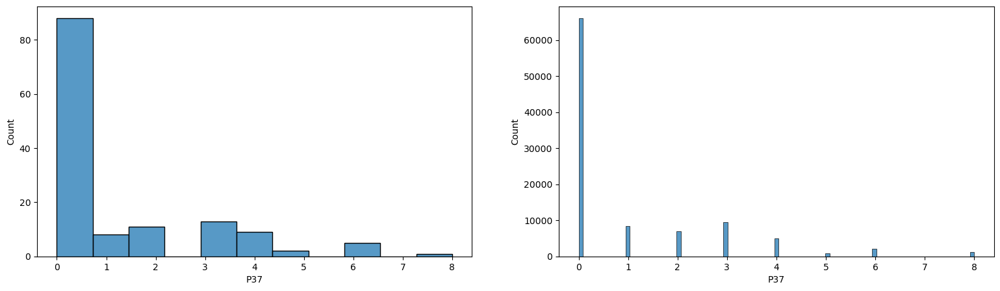

In [15]:
plt.rc('figure', max_open_warning = 0)
for i in range(1,38):
    fig, ax = plt.subplots(1,2, figsize=(19, 5))
    g1 = sns.histplot(df['P{}'.format(i)], ax=ax[0], kde=False);
    g2 = sns.histplot(test_df['P{}'.format(i)], ax=ax[1], kde=False);
    plt.show()

### variable types

In [15]:
df.dtypes

City Group     object
Type           object
P1              int64
P2            float64
P3            float64
P4            float64
P5              int64
P6              int64
P7              int64
P8              int64
P9              int64
P10             int64
P11             int64
P12             int64
P13           float64
P14             int64
P15             int64
P16             int64
P17             int64
P18             int64
P19             int64
P20             int64
P21             int64
P22             int64
P23             int64
P24             int64
P25             int64
P26           float64
P27           float64
P28           float64
P29           float64
P30             int64
P31             int64
P32             int64
P33             int64
P34             int64
P35             int64
P36             int64
P37             int64
revenue       float64
Days Open     float64
dtype: object

### target variable

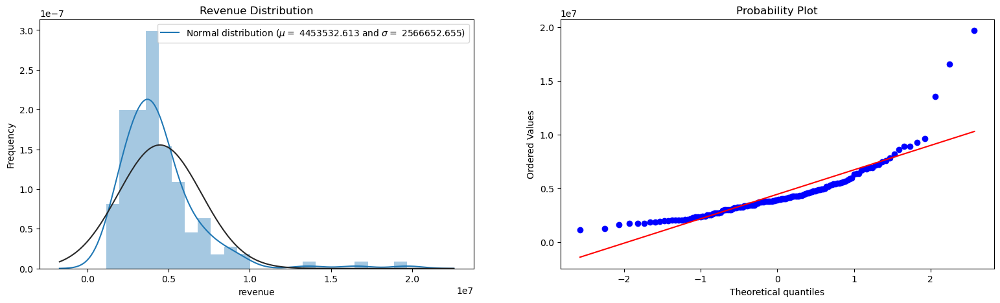

In [16]:
(mu, sigma) = norm.fit(df['revenue'])
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(19, 5))
ax1 = sns.distplot(df['revenue'] , fit=norm, ax=ax1)
ax1.legend([f'Normal distribution ($\mu=$ {mu:.3f} and $\sigma=$ {sigma:.3f})'], loc='best')
ax1.set_ylabel('Frequency')
ax1.set_title('Revenue Distribution')
ax2 = stats.probplot(df['revenue'], plot=plt)
f.show();

#### Transformation of the target variable

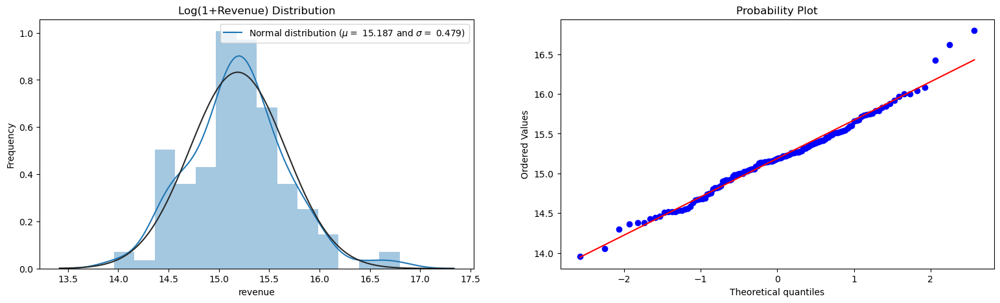

In [17]:
# Revenue is right skewed, taking the log will make it more normally distributed for the linear models
# Remember to use expm1 on predictions to transform back to dollar amount
(mu, sigma) = norm.fit(np.log1p(df['revenue']))
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(19, 5))
ax1 = sns.distplot(np.log1p(df['revenue']) , fit=norm, ax=ax1)
ax1.legend([f'Normal distribution ($\mu=$ {mu:.3f} and $\sigma=$ {sigma:.3f})'], loc='best')
ax1.set_ylabel('Frequency')
ax1.set_title('Log(1+Revenue) Distribution')
ax2 = stats.probplot(np.log(df['revenue']), plot=plt)
f.show();

In [18]:
# cap revenue at 10,000,000 for outliers
df.loc[df['revenue'] > 10000000, 'revenue'] = 10000000

#### Correlation Analysis

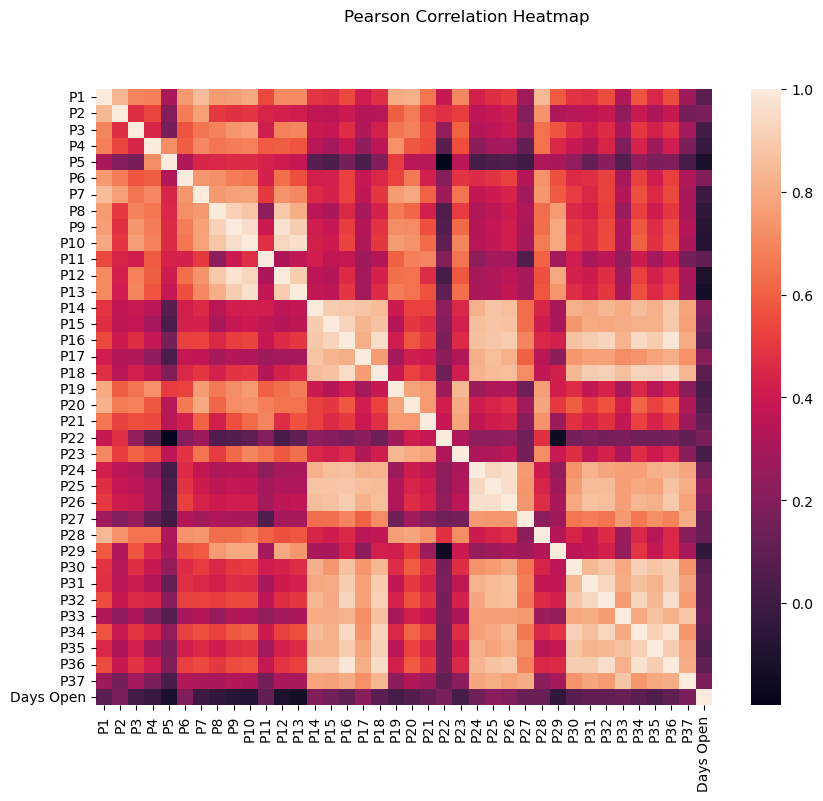

In [20]:
# Correlation between numeric features with revenue
plt.figure(figsize=(10, 8))
sns.heatmap(df.drop(['revenue','City Group','Type'], axis=1).corr(), square=True)
plt.suptitle('Pearson Correlation Heatmap')
plt.show();

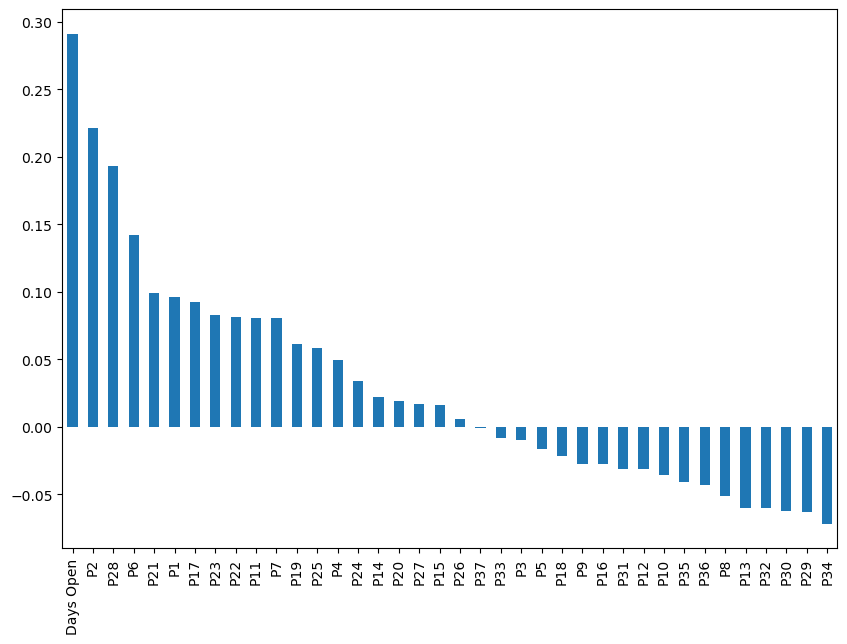

In [21]:
# Correlation between numeric features with revenue
corr_with_revenue = df.drop(['City Group','Type'],axis=1).corr()['revenue'].sort_values(ascending=False)
plt.figure(figsize=(10,7))
corr_with_revenue.drop('revenue').plot.bar()
plt.show();

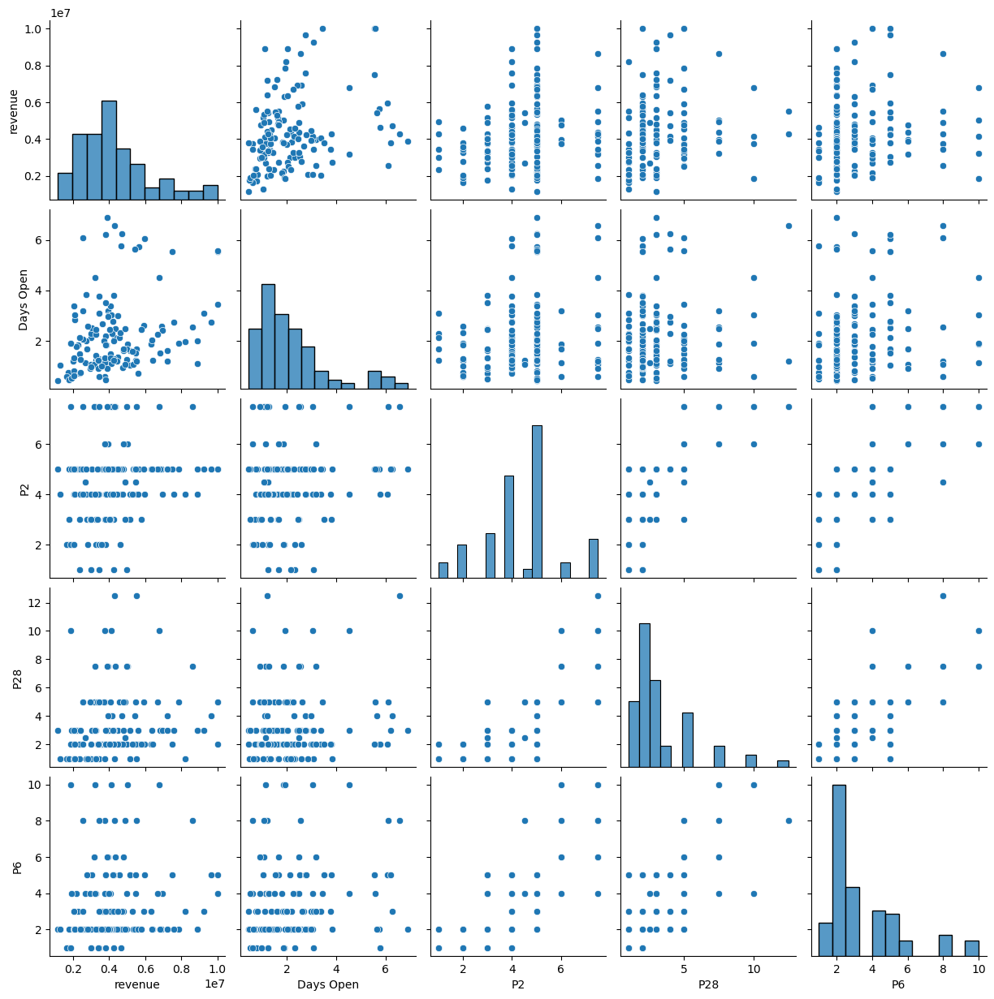

In [22]:
# Correlation between numeric features with revenue
df1 = df.drop(["City Group","Type"], axis=1)
sns.pairplot(df1[df1.corr()['revenue'].sort_values(ascending=False).index[:5]])
plt.show();

### Pandas Profiling

In [24]:
# Automated exploratory data analysis (EDA)
from ydata_profiling import ProfileReport

profile = ProfileReport(df, title="Profiling Report")

profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Part II: Features Engineering


#### Transformation of variables (Distribution)

In [11]:
#copying the dataframe
copy_df = df.copy()
copy_test_df = test_df.copy()

#index numeric variables
numeric_features = df.dtypes[df.dtypes != "object"].index

#estimating asymmetry
skewed_features = df[numeric_features].apply(lambda x: skew(x))
skewed_features = skewed_features[skewed_features > 0.5].index

#applying a log transformation to the biased variables
df[skewed_features] = np.log1p(df[skewed_features])
test_df[skewed_features.drop('revenue')] = np.log1p(test_df[skewed_features.drop('revenue')])

#### Treatment of missing values (null)

There are zero values that are actually null values. Multivariate imputation using chained equations (also known as MICE) was used to replace missing values in some of these characteristics. 

In [12]:
from sklearn.impute import SimpleImputer
#For the case of missing values (nan)
#imp_mean = SimpleImputer(missing_values=np.nan, strategy='mean')

#Values equal to 0 are considered missing values
imp_mean = SimpleImputer(missing_values= 0, strategy='mean')

#transformation application
p_data = ['P'+str(i) for i in range(1,38)]
df[p_data] = np.round(imp_mean.fit_transform(df[p_data]))
test_df[p_data] = np.round(imp_mean.fit_transform(test_df[p_data]))

In [13]:

# Above handles skewed features using log transformation
# Below uses multiple imputation for P1-P37, since they are actually categorical
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

imp_train = IterativeImputer(max_iter=10, missing_values=0, sample_posterior=True, min_value=1, random_state=37)
imp_test = IterativeImputer(max_iter=10, missing_values=0, sample_posterior=True, min_value=1, random_state=23)


p_data = ['P'+str(i) for i in range(1,38)]
df[p_data] = np.round(imp_train.fit_transform(df[p_data]))
test_df[p_data] = np.round(imp_test.fit_transform(test_df[p_data]))

#### Transformation of categorical variables into numerical ones

In [14]:
# drop_first=True for Dummy Encoding for object types, and drop_first=False for OHE
columnsToEncode = df.select_dtypes(include=[object]).columns
df = pd.get_dummies(df, columns=columnsToEncode, drop_first=False)
test_df = pd.get_dummies(test_df, columns=columnsToEncode, drop_first=False)

In [15]:
#apply the log transformation to the v.a. revenue
df['revenue'] = np.log1p(df['revenue'])

#split the v.a. in X and y, where X is all but revenue and y is revenue
X, y = df.drop('revenue', axis=1), df['revenue']

#split in training (80%) and test (20%) databases
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=118)

## Part III: Simple Regression Models

### Ridge Regression

In [16]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso

In [17]:
#parameters Ridge
print(Ridge().get_params())

{'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'max_iter': None, 'positive': False, 'random_state': None, 'solver': 'auto', 'tol': 0.0001}


In [18]:
#Hyperparameter matrix
params_ridge = {
    'alpha' : [.01, .1, .5, .7, .9, .95, .99, 1, 5, 10, 20],
    'fit_intercept' : [True, False],
    'solver' : ['svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga']
}

# Create an instance of the model
ridge_model = Ridge()

#model with optimized parameters 
ridge_regressor = GridSearchCV(ridge_model, params_ridge, scoring='neg_root_mean_squared_error', cv=5, n_jobs=-1)

#model fit
ridge_regressor.fit(X_train, y_train)


GridSearchCV(cv=5, estimator=Ridge(), n_jobs=-1,
             param_grid={'alpha': [0.01, 0.1, 0.5, 0.7, 0.9, 0.95, 0.99, 1, 5,
                                   10, 20],
                         'fit_intercept': [True, False],
                         'solver': ['svd', 'cholesky', 'lsqr', 'sparse_cg',
                                    'sag', 'saga']},
             scoring='neg_root_mean_squared_error')

In [19]:
#best combination of hyperparameters
print(f'Optimal alpha: {ridge_regressor.best_params_["alpha"]:.2f}')
print(f'Optimal fit_intercept: {ridge_regressor.best_params_["fit_intercept"]}')
print(f'Optimal solver: {ridge_regressor.best_params_["solver"]}')
print(f'Best score: {ridge_regressor.best_score_}')

Optimal alpha: 20.00
Optimal fit_intercept: True
Optimal solver: saga
Best score: -0.028412086756923183


In [20]:
# Create an instance of the model with optimized hyperparameters
ridge_model = Ridge(alpha=ridge_regressor.best_params_["alpha"], fit_intercept=ridge_regressor.best_params_["fit_intercept"], 
                    solver=ridge_regressor.best_params_["solver"])

In [21]:
#Model fit
ridge_model.fit(X_train, y_train)

#Prediction for training BD
y_train_pred = ridge_model.predict(X_train)

#Prediction for testing BD
y_pred = ridge_regressor.predict(X_test)

In [22]:
#model evaluation
print('Train r2 score: ', r2_score(y_train_pred, y_train))
print('Test r2 score: ', r2_score(y_test, y_pred))
train_rmse = np.sqrt(mean_squared_error(y_train_pred, y_train))
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Train RMSE: {train_rmse:.4f}')
print(f'Test RMSE: {test_rmse:.4f}')

Train r2 score:  -6.492722018879238
Test r2 score:  0.14792287116119673
Train RMSE: 0.0246
Test RMSE: 0.0314


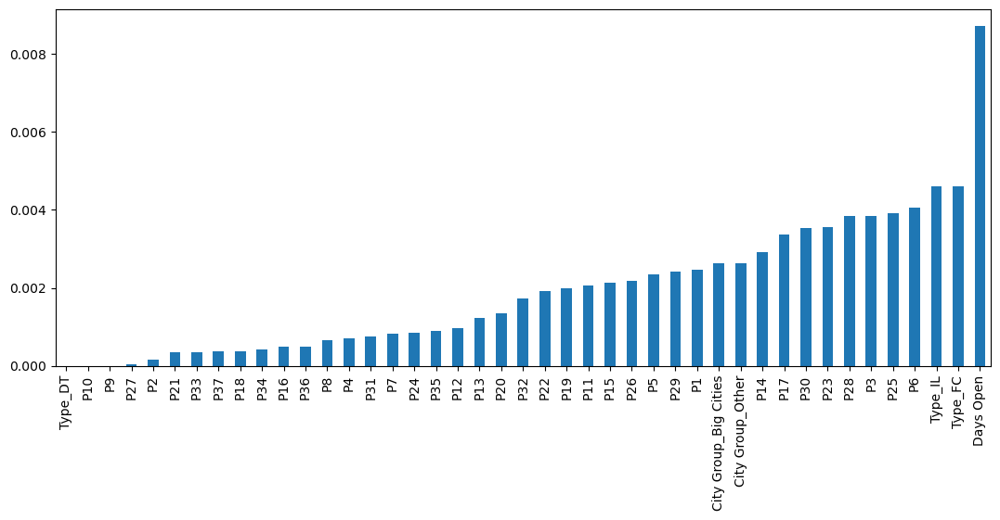

In [23]:
# Ridge Model Feature Importance
ridge_feature_coef = pd.Series(index = X_train.columns, data = np.abs(ridge_model.coef_))
ridge_feature_coef.sort_values().plot(kind = 'bar', figsize = (13,5));

### Lasso Linear Model

In [24]:
#parameters Lasso
print(Lasso().get_params())

{'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': None, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}


In [25]:
#Hyperparameter matrix
params_lasso = {
    'alpha' : [.01, .1, .5, .7, .9, .95, .99, 1, 5, 10, 20],
    'fit_intercept' : [True, False],
}
# Create an instance of the model
lasso_model = Lasso()

#model with optimized parameters  
lasso_regressor = GridSearchCV(lasso_model, params_lasso, scoring='neg_root_mean_squared_error', cv=5, n_jobs=-1)

#Model fit
lasso_regressor.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=Lasso(), n_jobs=-1,
             param_grid={'alpha': [0.01, 0.1, 0.5, 0.7, 0.9, 0.95, 0.99, 1, 5,
                                   10, 20],
                         'fit_intercept': [True, False]},
             scoring='neg_root_mean_squared_error')

In [26]:
#best combination of hyperparameters
print(f'Optimal alpha: {lasso_regressor.best_params_["alpha"]:.2f}')
print(f'Optimal fit_intercept: {lasso_regressor.best_params_["fit_intercept"]}')
print(f'Best score: {lasso_regressor.best_score_}')

Optimal alpha: 0.01
Optimal fit_intercept: True
Best score: -0.028178541287918663


In [27]:
# Create an instance of the model with optimized hyperparameters
lasso_model = Lasso(alpha=lasso_regressor.best_params_["alpha"], fit_intercept=lasso_regressor.best_params_["fit_intercept"], 
                    )

In [28]:
#Model fit
lasso_model.fit(X_train, y_train)

#Prediction for training BD
y_train_pred = lasso_model.predict(X_train)

#Prediction for testing BD
y_pred = lasso_model.predict(X_test)

In [29]:
#model evaluation
print('Train r2 score: ', r2_score(y_train_pred, y_train))
print('Test r2 score: ', r2_score(y_test, y_pred))
train_rmse = np.sqrt(mean_squared_error(y_train_pred, y_train))
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Train RMSE: {train_rmse:.4f}')
print(f'Test RMSE: {test_rmse:.4f}')

Train r2 score:  -2.511363137729299e+26
Test r2 score:  -0.015321579722836765
Train RMSE: 0.0282
Test RMSE: 0.0343


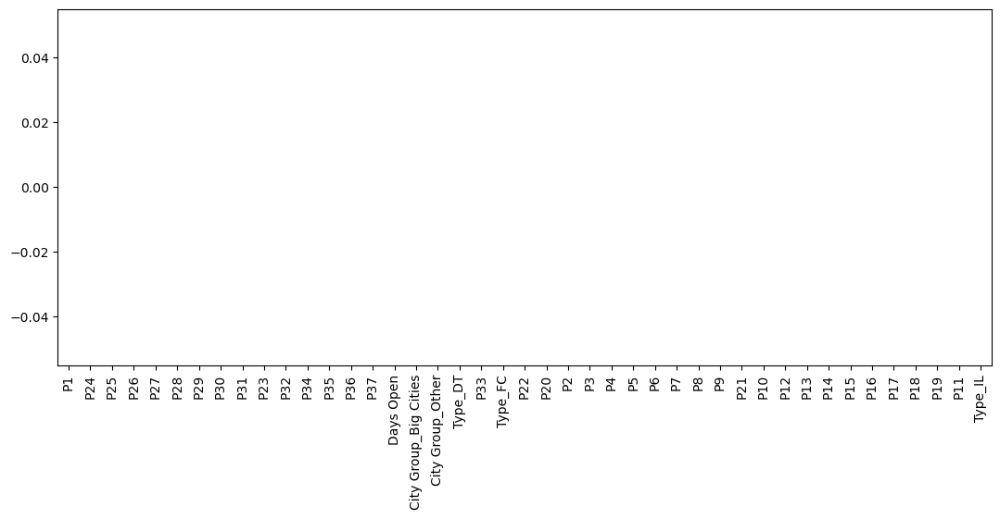

In [30]:
# Lasso Model Feature Importance
lasso_feature_coef = pd.Series(index = X_train.columns, data = np.abs(lasso_model.coef_))
lasso_feature_coef.sort_values().plot(kind = 'bar', figsize = (13,5));

### ElasticNet (Combinación de Ridge y Lasso)

In [48]:
from sklearn.linear_model import ElasticNetCV, ElasticNet

In [49]:
#parameters ElasticNetCV
print(ElasticNetCV().get_params())

{'alphas': None, 'copy_X': True, 'cv': None, 'eps': 0.001, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': None, 'positive': False, 'precompute': 'auto', 'random_state': None, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': 0}


In [50]:
# Use ElasticNetCV to tune alpha automatically instead of redundantly using ElasticNet and GridSearchCV

#Hyperparameter
el_model = ElasticNetCV(l1_ratio=[.1, .5, .7, .9, .95, .99, 1], eps=5e-2, cv=10, n_jobs=-1)         

#Model fit
el_model.fit(X_train, y_train)

ElasticNetCV(cv=10, eps=0.05, l1_ratio=[0.1, 0.5, 0.7, 0.9, 0.95, 0.99, 1],
             n_jobs=-1)

In [51]:
#best combination of hyperparameters
print(f'Optimal alpha: {el_model.alpha_:.6f}')
print(f'Optimal l1_ratio: {el_model.l1_ratio_:.3f}')
print(f'Number of iterations {el_model.n_iter_}')

Optimal alpha: 0.001891
Optimal l1_ratio: 1.000
Number of iterations 4


In [52]:
#Prediction for training BD
y_train_pred = el_model.predict(X_train)

#Prediction for testing BD
y_pred = el_model.predict(X_test)

In [53]:
#model evaluation
print('Train r2 score: ', r2_score(y_train_pred, y_train))
print('Test r2 score: ', r2_score(y_test, y_pred))
train_rmse = np.sqrt(mean_squared_error(y_train_pred, y_train))
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Train RMSE: {train_rmse:.4f}')
print(f'Test RMSE: {test_rmse:.4f}')

Train r2 score:  -26.85776855814045
Test r2 score:  0.11787813179407791
Train RMSE: 0.0258
Test RMSE: 0.0287


In [54]:
# ElasticNet Model Feature Importance
el_feature_coef = pd.Series(index = X_train.columns, data = np.abs(el_model.coef_))
n_features = (el_feature_coef>0).sum()
print(f'{n_features} features with reduction of {(1-n_features/len(el_feature_coef))*100:2.2f}%')

4 features with reduction of 90.70%


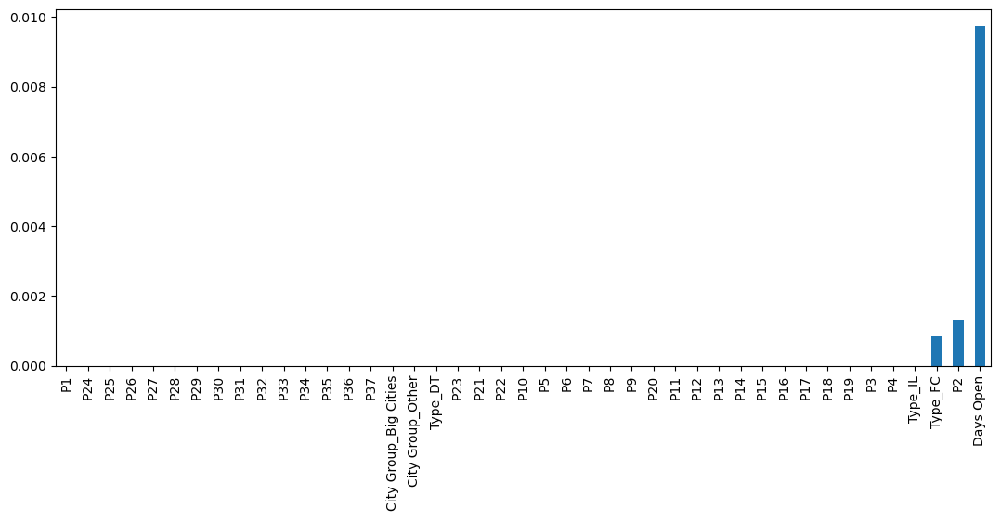

In [55]:
#Graph Model Feature Importance
el_feature_coef.sort_values().plot(kind = 'bar', figsize = (13,5));

### K-Nearest Neighbors

In [21]:
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsRegressor

In [22]:
#parameters KNeighbors Regressor
print(KNeighborsRegressor().get_params())

{'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}


In [26]:
#Hyperparameter
params_knn = {
    'n_neighbors' : [3, 5, 7, 9, 11],
}

# Create an instance of the model
knn_model = KNeighborsRegressor()

#model with optimized parameters  
knn_regressor = GridSearchCV(knn_model, params_knn, scoring='neg_root_mean_squared_error', cv=10, n_jobs=-1)

#Model fit
knn_regressor.fit(X_train, y_train)

GridSearchCV(cv=10, estimator=KNeighborsRegressor(), n_jobs=-1,
             param_grid={'n_neighbors': [3, 5, 7, 9, 11]},
             scoring='neg_root_mean_squared_error')

In [27]:
#best combination of hyperparameters
print(f'Optimal neighbors: {knn_regressor.best_params_["n_neighbors"]}')
print(f'Best score: {knn_regressor.best_score_}')

Optimal neighbors: 11
Best score: -0.028998833773491706


In [28]:
# Create an instance of the model with optimized hyperparameters
knn_model = KNeighborsRegressor(n_neighbors=knn_regressor.best_params_["n_neighbors"])

#Model fit
knn_model.fit(X_train, y_train)

#Prediction for training BD
y_train_pred = knn_model.predict(X_train)

#Prediction for testing BD
y_pred = knn_model.predict(X_test)

#model evaluation
print('Train r2 score: ', r2_score(y_train_pred, y_train))
print('Test r2 score: ', r2_score(y_test, y_pred))
train_rmse = np.sqrt(mean_squared_error(y_train_pred, y_train))
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Train RMSE: {train_rmse:.4f}')
print(f'Test RMSE: {test_rmse:.4f}')

Train r2 score:  -16.163177185919768
Test r2 score:  -0.048341597731055286
Train RMSE: 0.0272
Test RMSE: 0.0348


# Parte IV: Modelos Complejos de Regresión

## Random Forest

In [31]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor

In [32]:
#parameters Random Forest
print(RandomForestRegressor().get_params())

{'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': None, 'verbose': 0, 'warm_start': False}


In [33]:
#Hyperparameter matrix
params_rf = {
    'max_depth': [10, 30, 35, 50, 65, 75, 100],
    'max_features': [.3, .4, .5, .6],
    'min_samples_leaf': [3, 4, 5],
    'min_samples_split': [8, 10, 12],
    'n_estimators': [30, 50, 100, 200]
}

# Create an instance of the model
rf = RandomForestRegressor()

#model with optimized parameters
rf_regressor = GridSearchCV(rf, params_rf, scoring='neg_root_mean_squared_error', cv = 10, n_jobs = -1)

#Model fit
rf_regressor.fit(X_train, y_train)

GridSearchCV(cv=10, estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'max_depth': [10, 30, 35, 50, 65, 75, 100],
                         'max_features': [0.3, 0.4, 0.5, 0.6],
                         'min_samples_leaf': [3, 4, 5],
                         'min_samples_split': [8, 10, 12],
                         'n_estimators': [30, 50, 100, 200]},
             scoring='neg_root_mean_squared_error')

In [34]:
#best combination of hyperparameters
print(f'Optimal depth: {rf_regressor.best_params_["max_depth"]}')
print(f'Optimal max_features: {rf_regressor.best_params_["max_features"]}')
print(f'Optimal min_sample_leaf: {rf_regressor.best_params_["min_samples_leaf"]}')
print(f'Optimal min_samples_split: {rf_regressor.best_params_["min_samples_split"]}')
print(f'Optimal n_estimators: {rf_regressor.best_params_["n_estimators"]}')
print(f'Best score: {rf_regressor.best_score_}')

Optimal depth: 75
Optimal max_features: 0.6
Optimal min_sample_leaf: 5
Optimal min_samples_split: 10
Optimal n_estimators: 30
Best score: -0.024601942754600297


In [35]:
# Create an instance of the model with optimized hyperparameters
rf_model = RandomForestRegressor(max_depth=rf_regressor.best_params_["max_depth"], 
                                 max_features=rf_regressor.best_params_["max_features"], 
                                 min_samples_leaf=rf_regressor.best_params_["min_samples_leaf"], 
                                 min_samples_split=rf_regressor.best_params_["min_samples_split"], 
                                 n_estimators=rf_regressor.best_params_["n_estimators"], 
                                 n_jobs=-1, oob_score=True)
#Model fit
rf_model.fit(X_train, y_train)

#Prediction for training BD
y_train_pred = rf_model.predict(X_train)

#Prediction for testing BD
y_pred = rf_model.predict(X_test)

#model evaluation
print('Train r2 score: ', r2_score(y_train_pred, y_train))
print('Test r2 score: ', r2_score(y_test, y_pred))
train_rmse = np.sqrt(mean_squared_error(y_train_pred, y_train))
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Train RMSE: {train_rmse:.4f}')
print(f'Test RMSE: {test_rmse:.4f}')

Train r2 score:  -1.0278578561110643
Test r2 score:  0.26109061912612896
Train RMSE: 0.0202
Test RMSE: 0.0292


34 features with reduction of 20.93%


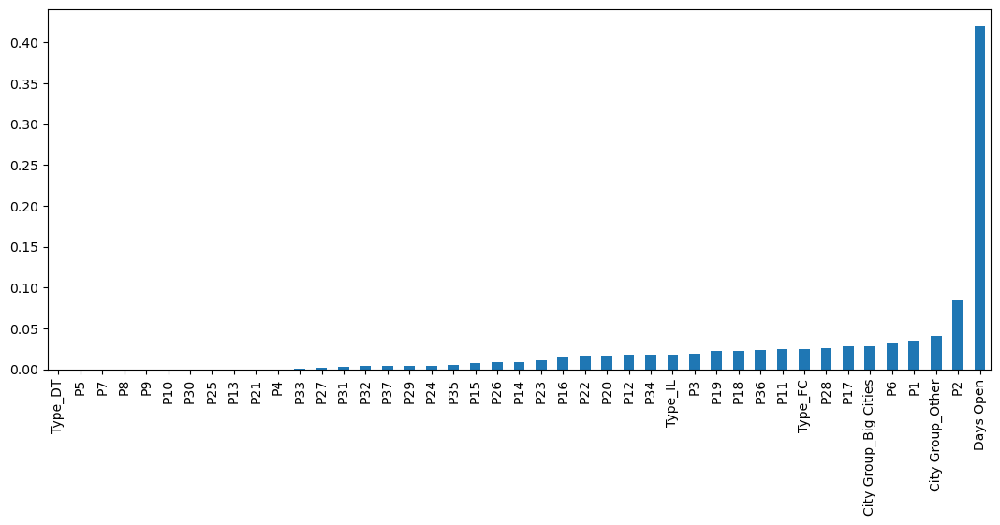

In [36]:
# Random Forest Model Feature Importance
rf_feature_importance = pd.Series(index = X_train.columns, data = np.abs(rf_model.feature_importances_))
n_features = (rf_feature_importance>0).sum()
print(f'{n_features} features with reduction of {(1-n_features/len(rf_feature_importance))*100:2.2f}%')
rf_feature_importance.sort_values().plot(kind = 'bar', figsize = (13,5));

## Light GBM

In [28]:
#!pip install lightgbm

  Obtaining dependency information for lightgbm from https://files.pythonhosted.org/packages/e1/4c/4685ccfae9806f561de716e32549190c1f533dde5bcadaf83bdf23972cf0/lightgbm-4.3.0-py3-none-win_amd64.whl.metadata
   ---------------------------------------- 0.0/1.3 MB ? eta -:--:--
   ----- ---------------------------------- 0.2/1.3 MB 5.1 MB/s eta 0:00:01
   ---------------------- ----------------- 0.7/1.3 MB 9.5 MB/s eta 0:00:01
   ---------------------------------------- 1.3/1.3 MB 12.1 MB/s eta 0:00:00


In [29]:
import lightgbm as lgbm

In [30]:
#Hyperparameter matrix
params_lgbm = {
    'learning_rate': [.01, .1, .5, .7, .9, .95, .99, 1],
    'boosting': ['gbdt'],
    'metric': ['l1'],
    'feature_fraction': [.3, .4, .5, 1],
    'num_leaves': [20],
    'min_data': [10],
    'max_depth': [10],
    'n_estimators': [10, 30, 50, 100]
}

# Create an instance of the model
lgb = lgbm.LGBMRegressor()

#model with optimized parameters  
lgb_regressor = GridSearchCV(lgb, params_lgbm, scoring='neg_root_mean_squared_error', cv = 10, n_jobs = -1)

#Model fit
lgb_regressor.fit(X_train, y_train)

#best combination of hyperparameters
print(f'Optimal lr: {lgb_regressor.best_params_["learning_rate"]}')
print(f'Optimal feature_fraction: {lgb_regressor.best_params_["feature_fraction"]}')
print(f'Optimal n_estimators: {lgb_regressor.best_params_["n_estimators"]}')
print(f'Best score: {lgb_regressor.best_score_}')

[LightGBM] [Warning] min_data_in_leaf is set with min_child_samples=20, will be overridden by min_data=10. Current value: min_data_in_leaf=10
[LightGBM] [Warning] feature_fraction is set=0.3, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.3
[LightGBM] [Warning] boosting is set=gbdt, boosting_type=gbdt will be ignored. Current value: boosting=gbdt
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] min_data_in_leaf is set with min_child_samples=20, will be overridden by min_data=10. Current value: min_data_in_leaf=10
[LightGBM] [Warning] feature_fraction is set=0.3, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.3
[LightGBM] [Warning] boosting is set=gbdt, boosting_type=gbdt will be ignored. Current value: boosting=gbdt
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003787 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if mem

In [31]:
# Create an instance of the model with optimized hyperparameters
lgb_model = lgbm.LGBMRegressor(learning_rate=lgb_regressor.best_params_["learning_rate"], boosting='gbdt', 
                               metric='l1', feature_fraction=lgb_regressor.best_params_["feature_fraction"], 
                               num_leaves=20, min_data=10, max_depth=10, 
                               n_estimators=lgb_regressor.best_params_["n_estimators"], n_jobs=-1)
#Model fit
lgb_model.fit(X_train, y_train)

#Prediction for training BD
y_train_pred = lgb_model.predict(X_train)

#Prediction for testing BD
y_pred = lgb_model.predict(X_test)

#model evaluation
print('Train r2 score: ', r2_score(y_train_pred, y_train))
print('Test r2 score: ', r2_score(y_test, y_pred))
train_rmse = np.sqrt(mean_squared_error(y_train_pred, y_train))
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Train RMSE: {train_rmse:.4f}')
print(f'Test RMSE: {test_rmse:.4f}')

[LightGBM] [Warning] min_data_in_leaf is set with min_child_samples=20, will be overridden by min_data=10. Current value: min_data_in_leaf=10
[LightGBM] [Warning] feature_fraction is set=0.3, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.3
[LightGBM] [Warning] boosting is set=gbdt, boosting_type=gbdt will be ignored. Current value: boosting=gbdt
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] min_data_in_leaf is set with min_child_samples=20, will be overridden by min_data=10. Current value: min_data_in_leaf=10
[LightGBM] [Warning] feature_fraction is set=0.3, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.3
[LightGBM] [Warning] boosting is set=gbdt, boosting_type=gbdt will be ignored. Current value: boosting=gbdt
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002943 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM]

27 features with reduction of 37.21%


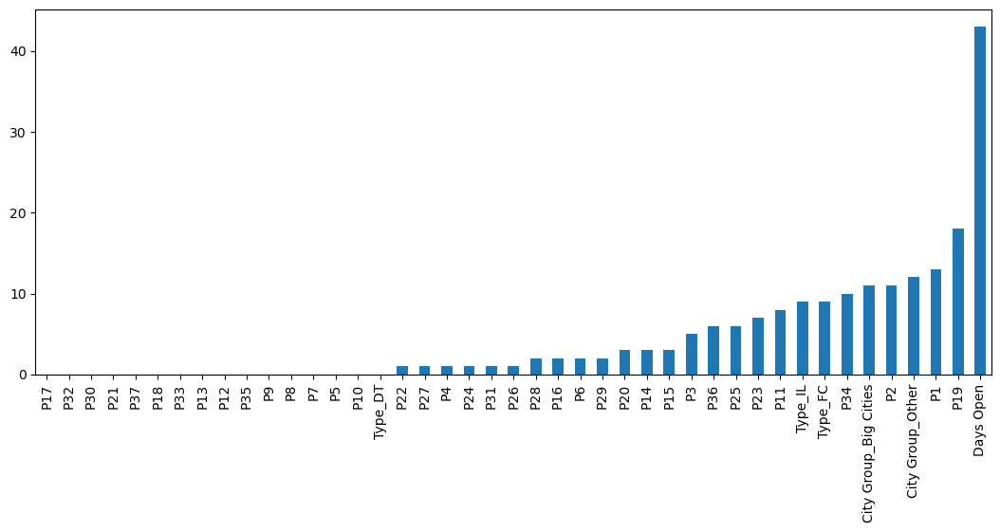

In [32]:
# LightGBM Feature Importance
lgb_feature_importance = pd.Series(index = X_train.columns, data = np.abs(lgb_model.feature_importances_))
n_features = (lgb_feature_importance>0).sum()
print(f'{n_features} features with reduction of {(1-n_features/len(lgb_feature_importance))*100:2.2f}%')
lgb_feature_importance.sort_values().plot(kind = 'bar', figsize = (13,5));

## XGBoost

In [45]:
#Hyperparameter matrix
params_xgb = {
    'learning_rate': [.1, .5, .7, .9, .95, .99, 1],
    'colsample_bytree': [.3, .4, .5, .6],
    'max_depth': [4],
    'alpha': [3],
    'subsample': [.5],
    'n_estimators': [30, 70, 100, 200]
}

# Create an instance of the model
xgb_model = XGBRegressor()

#model with optimized parameters  
xgb_regressor = GridSearchCV(xgb_model, params_xgb, scoring='neg_root_mean_squared_error', cv = 10, n_jobs = -1)

#Model fit
xgb_regressor.fit(X_train, y_train)

#best combination of hyperparameters
print(f'Optimal lr: {xgb_regressor.best_params_["learning_rate"]}')
print(f'Optimal colsample_bytree: {xgb_regressor.best_params_["colsample_bytree"]}')
print(f'Optimal n_estimators: {xgb_regressor.best_params_["n_estimators"]}')
print(f'Best score: {xgb_regressor.best_score_}')

Optimal lr: 0.1
Optimal colsample_bytree: 0.3
Optimal n_estimators: 30
Best score: -0.027516589641871547


In [46]:
# Create an instance of the model with optimized hyperparameters
xgb_model = XGBRegressor(learning_rate=xgb_regressor.best_params_["learning_rate"], 
                         colsample_bytree=xgb_regressor.best_params_["colsample_bytree"], 
                         max_depth=4, alpha=3, subsample=.5, 
                         n_estimators=xgb_regressor.best_params_["n_estimators"], n_jobs=-1)
#model fit
xgb_model.fit(X_train, y_train)

#Prediction for training BD
y_train_pred = xgb_model.predict(X_train)

#Prediction for testing BD
y_pred = xgb_model.predict(X_test)

#model evaluation
print('Train r2 score: ', r2_score(y_train_pred, y_train))
print('Test r2 score: ', r2_score(y_test, y_pred))
train_rmse = np.sqrt(mean_squared_error(y_train_pred, y_train))
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Train RMSE: {train_rmse:.4f}')
print(f'Test RMSE: {test_rmse:.4f}')

Train r2 score:  -13940865892.571962
Test r2 score:  -0.015322012497738235
Train RMSE: 0.0282
Test RMSE: 0.0343


In [47]:
# XGB with early stopping
xgb_model.fit(X_train, y_train, early_stopping_rounds=4,
             eval_set=[(X_test, y_test)], verbose=False)

#Prediction for training BD
y_train_pred = xgb_model.predict(X_train)

#Prediction for testing BD
y_pred = xgb_model.predict(X_test)

#model evaluation
print('Train r2 score: ', r2_score(y_train_pred, y_train))
print('Test r2 score: ', r2_score(y_test, y_pred))
train_rmse = np.sqrt(mean_squared_error(y_train_pred, y_train))
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Train RMSE: {train_rmse:.4f}')
print(f'Test RMSE: {test_rmse:.4f}')

Train r2 score:  -13940865892.571962
Test r2 score:  -0.015322012497738235
Train RMSE: 0.0282
Test RMSE: 0.0343


In [48]:
# XGB Feature Importance, relevant features can be selected based on its score
feature_important = xgb_model.get_booster().get_fscore()
keys = list(feature_important.keys())
values = list(feature_important.values())

data = pd.DataFrame(data=values, index=keys, columns=['score']).sort_values(by = 'score', ascending=True)
try:
    data.plot(kind='bar', figsize = (13,5))
    plt.show()
except TypeError:
    # Esto se ejecutará si se produce un TypeError
    print("Los datos no son numéricos y no se pueden trazar.")

Los datos no son numéricos y no se pueden trazar.


## Parte V: Ensemble models 

Based on the experimentation of the above models, it is clear that linear and KNN models are not the best models for this data set. Therefore, they will not be used as part of the set. The best models to assemble would be the random forest and the XGBoost models.

## Regressor Ensembling

In [37]:

rf_model_en = RandomForestRegressor(max_depth=200, max_features=0.4, min_samples_leaf=3, 
                                 min_samples_split=6, n_estimators=30, n_jobs=-1, oob_score=True)
rf_model_en.fit(X_train, y_train)
y_train_pred = rf_model_en.predict(X_train)
y_pred = rf_model_en.predict(X_test)
print('Train r2 score: ', r2_score(y_train_pred, y_train))
print('Test r2 score: ', r2_score(y_test, y_pred))
train_rmse = np.sqrt(mean_squared_error(y_train_pred, y_train))
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Train RMSE: {train_rmse:.4f}')
print(f'Test RMSE: {test_rmse:.4f}')

Train r2 score:  -0.24977417686624181
Test r2 score:  0.23078054798121916
Train RMSE: 0.0176
Test RMSE: 0.0298


ridge -0.023 0.005
lasso -0.022 0.006
rf_en -0.021 0.005
stacking -0.021 0.005


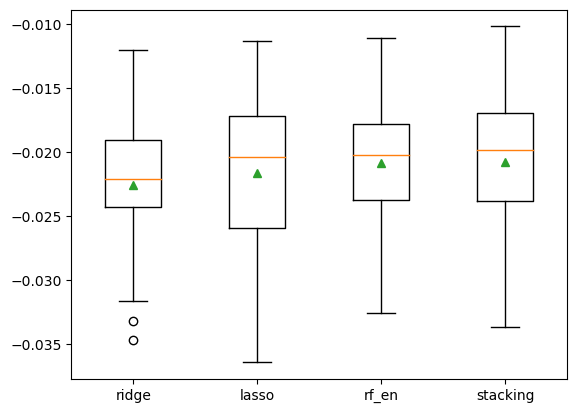

In [38]:
from numpy import mean
from numpy import std
from sklearn.datasets import make_regression
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import StackingRegressor
from matplotlib import pyplot

# get a stacking ensemble of models
def get_stacking():
    # define the base models
    base_models = list()
    base_models.append(('ridge', ridge_model))
    base_models.append(('lasso', lasso_model))
    base_models.append(('rf', rf_model_en))
    # define meta learner model
    learner = LinearRegression()
    # define the stacking ensemble
    model = StackingRegressor(estimators=base_models, final_estimator=learner, cv=10)
    return model
 
# get a list of models to evaluate
def get_models():
    models = dict()
    models['ridge'] = ridge_model
    models['lasso'] = lasso_model
    models['rf_en'] = rf_model_en
    models['stacking'] = get_stacking()
    return models
 
# evaluate a given model using cross-validation
def evaluate_model(model, X, y):
    cv = RepeatedKFold(n_splits=10, n_repeats=5, random_state=19)
    scores = cross_val_score(model, X, y, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
    return scores

# get the models to evaluate
models = get_models()
# evaluate the models and store results
results, names = list(), list()

for name, model in models.items():
    scores = evaluate_model(model, X_train, y_train)
    results.append(scores)
    names.append(name)
    print(f'{name} {mean(scores):.3f} {std(scores):.3f}')
    
# plot model performance for comparison
pyplot.boxplot(results, labels=names, showmeans=True)
pyplot.show()

In [39]:
# define the base models
base_models = list()
base_models.append(('ridge', ridge_model))
base_models.append(('lasso', lasso_model))
base_models.append(('rf', rf_model_en))
# define meta learner model
learner = LinearRegression()
# define the stacking ensemble
stack1 = StackingRegressor(estimators=base_models, final_estimator=learner, cv=10)
# fit the model on all available data
stack1.fit(X, y)

StackingRegressor(cv=10,
                  estimators=[('ridge', Ridge(alpha=20, solver='saga')),
                              ('lasso', Lasso(alpha=0.01)),
                              ('rf',
                               RandomForestRegressor(max_depth=200,
                                                     max_features=0.4,
                                                     min_samples_leaf=3,
                                                     min_samples_split=6,
                                                     n_estimators=30, n_jobs=-1,
                                                     oob_score=True))],
                  final_estimator=LinearRegression())

In [40]:
y_train_pred = stack1.predict(X_train)
y_pred = stack1.predict(X_test)
print('Train r2 score: ', r2_score(y_train_pred, y_train))
print('Test r2 score: ', r2_score(y_test, y_pred))
train_rmse = np.sqrt(mean_squared_error(y_train_pred, y_train))
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Train RMSE: {train_rmse:.4f}')
print(f'Test RMSE: {test_rmse:.4f}')

Train r2 score:  -1.2847839587410852
Test r2 score:  0.4494545492153915
Train RMSE: 0.0199
Test RMSE: 0.0252


In [41]:
# define the base models
base_model = list()
base_model.append(('rf1', rf_model))
base_model.append(('rf2', rf_model_en))
base_model.append(('rf3', RandomForestRegressor(max_depth=8, max_features=0.1, min_samples_leaf=3, 
                                                min_samples_split=2, n_estimators=250, n_jobs=-1, oob_score=False)))
# define meta learner model
learner = LinearRegression()
# define the stacking ensemble
stack2 = StackingRegressor(estimators=base_model, final_estimator=learner, cv=10)
# fit the model on all available data
stack2.fit(X, y)

StackingRegressor(cv=10,
                  estimators=[('rf1',
                               RandomForestRegressor(max_depth=75,
                                                     max_features=0.6,
                                                     min_samples_leaf=5,
                                                     min_samples_split=10,
                                                     n_estimators=30, n_jobs=-1,
                                                     oob_score=True)),
                              ('rf2',
                               RandomForestRegressor(max_depth=200,
                                                     max_features=0.4,
                                                     min_samples_leaf=3,
                                                     min_samples_split=6,
                                                     n_estimators=30, n_jobs=-1,
                                                     oob_score=True)),
                              ('rf3',
                               RandomForestRegressor(max_depth=8,
                                                     max_features=0.1,
                                                     min_samples_leaf=3,
                                                     n_estimators=250,
                                                     n_jobs=-1))],
                  final_estimator=LinearRegression())

In [42]:
y_train_pred = stack2.predict(X_train)
y_pred = stack2.predict(X_test)
print('Train r2 score: ', r2_score(y_train_pred, y_train))
print('Test r2 score: ', r2_score(y_test, y_pred))
train_rmse = np.sqrt(mean_squared_error(y_train_pred, y_train))
test_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f'Train RMSE: {train_rmse:.4f}')
print(f'Test RMSE: {test_rmse:.4f}')

Train r2 score:  -0.7883901007324667
Test r2 score:  0.47743532237201836
Train RMSE: 0.0197
Test RMSE: 0.0246


# Parte VI: CI/CD con mlFlow

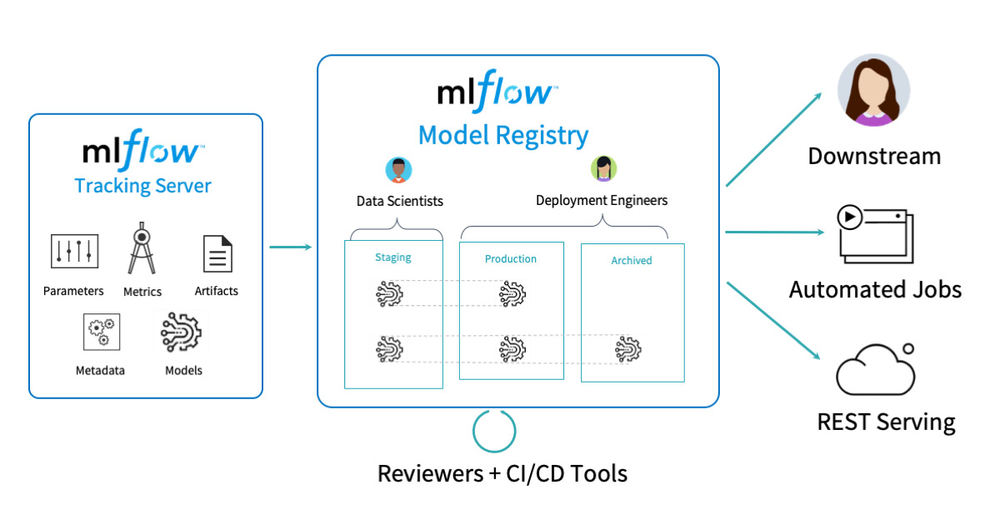

Fuente de la imagen: https://databricks.com/blog/2020/04/15/databricks-extends-mlflow-model-registry-with-enterprise-features.html

In [ ]:
#import mlflow
!mlflow ui

In [49]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import ElasticNet
from urllib.parse import urlparse
import mlflow
import mlflow.sklearn

import os
import warnings
import sys

def eval_metrics(actual, pred):
    rmse = np.sqrt(mean_squared_error(actual, pred))
    mae = mean_absolute_error(actual, pred)
    r2 = r2_score(actual, pred)
    return rmse, mae, r2

In [50]:

with mlflow.start_run():
    
    predicted_qualities = stack2.predict(X_test)

    (rmse, mae, r2) = eval_metrics(y_test, predicted_qualities)

    print("  RMSE: %s" % rmse)
    print("  MAE: %s" % mae)
    print("  R2: %s" % r2)

    #almacenar las metricas
    mlflow.log_metric("rmse", rmse)
    mlflow.log_metric("r2", r2)
    mlflow.log_metric("mae", mae)

    tracking_url_type_store = urlparse(mlflow.get_tracking_uri()).scheme

    # Model registry does not work with file store
    if tracking_url_type_store != "file":

        # Register the model
        # There are other ways to use the Model Registry, which depends on the use case,
        # please refer to the doc for more information:
        # https://mlflow.org/docs/latest/model-registry.html#api-workflow
        mlflow.sklearn.log_model(stack2, "model", registered_model_name="EnsembleModel")
    else:
        mlflow.sklearn.log_model(stack2, "model")

  RMSE: 0.02459403854415139
  MAE: 0.018988631924006634
  R2: 0.4774353223720177


In [ ]:
#import mlflow
!mlflow ui